<a href="https://colab.research.google.com/github/felixdivo/private-google-colab-saves/blob/main/notebooks/image_predictor_example.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Copyright (c) Meta Platforms, Inc. and affiliates.

# Object masks in images from prompts with SAM 2

Segment Anything Model 2 (SAM 2) predicts object masks given prompts that indicate the desired object. The model first converts the image into an image embedding that allows high quality masks to be efficiently produced from a prompt.

The `SAM2ImagePredictor` class provides an easy interface to the model for prompting the model. It allows the user to first set an image using the `set_image` method, which calculates the necessary image embeddings. Then, prompts can be provided via the `predict` method to efficiently predict masks from those prompts. The model can take as input both point and box prompts, as well as masks from the previous iteration of prediction.

<a target="_blank" href="https://colab.research.google.com/github/facebookresearch/sam2/blob/main/notebooks/image_predictor_example.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

## Environment Set-up

If running locally using jupyter, first install `sam2` in your environment using the [installation instructions](https://github.com/facebookresearch/sam2#installation) in the repository.

If running from Google Colab, set `using_colab=True` below and run the cell. In Colab, be sure to select 'GPU' under 'Edit'->'Notebook Settings'->'Hardware accelerator'. Note that it's recommended to use **A100 or L4 GPUs when running in Colab** (T4 GPUs might also work, but could be slow and might run out of memory in some cases).

In [ ]:
using_colab = True

In [ ]:
if using_colab:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())
    import sys
    !{sys.executable} -m pip install opencv-python matplotlib
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/sam2.git'

    !mkdir -p images
    !wget -P images https://raw.githubusercontent.com/facebookresearch/sam2/main/notebooks/images/truck.jpg
    !wget -P images https://raw.githubusercontent.com/facebookresearch/sam2/main/notebooks/images/groceries.jpg

    !mkdir -p ../checkpoints/
    !wget -P ../checkpoints/ https://dl.fbaipublicfiles.com/segment_anything_2/092824/sam2.1_hiera_large.pt

PyTorch version: 2.6.0+cu124
Torchvision version: 0.21.0+cu124
CUDA is available: True
  Cloning https://github.com/facebookresearch/sam2.git to /tmp/pip-req-build-wh_kkbm9
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/sam2.git /tmp/pip-req-build-wh_kkbm9
  Resolved https://github.com/facebookresearch/sam2.git to commit 2b90b9f5ceec907a1c18123530e92e794ad901a4
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 7.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 16.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8

## Set-up

Necessary imports and helper functions for displaying points, boxes, and masks.

In [ ]:
import os
# if using Apple MPS, fall back to CPU for unsupported ops
os.environ["PYTORCH_ENABLE_MPS_FALLBACK"] = "1"
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image

In [ ]:
# select the device for computation
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"using device: {device}")

if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
elif device.type == "mps":
    print(
        "\nSupport for MPS devices is preliminary. SAM 2 is trained with CUDA and might "
        "give numerically different outputs and sometimes degraded performance on MPS. "
        "See e.g. https://github.com/pytorch/pytorch/issues/84936 for a discussion."
    )

using device: cuda


In [ ]:
np.random.seed(3)

def show_mask(mask, ax, random_color=False, borders = True):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask = mask.astype(np.uint8)
    mask_image =  mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    if borders:
        import cv2
        contours, _ = cv2.findContours(mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        # Try to smooth contours
        contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
        mask_image = cv2.drawContours(mask_image, contours, -1, (1, 1, 1, 0.5), thickness=2)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))

def show_box_oriented(box, ax):
    ax.add_patch(plt.Polygon(box, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))

def show_masks(image, masks, scores, point_coords=None, box_coords=None, input_labels=None, borders=True):
    for i, (mask, score) in enumerate(zip(masks, scores)):
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        show_mask(mask, plt.gca(), borders=borders)
        if point_coords is not None:
            assert input_labels is not None
            show_points(point_coords, input_labels, plt.gca())
        if box_coords is not None:
            # boxes
            show_box(box_coords, plt.gca())
        if len(scores) > 1:
            plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
        plt.axis('off')
        plt.show()

## Example image

In [ ]:
from pathlib import Path

Path(".").absolute()

PosixPath('/content')

In [ ]:
image = Image.open('images/linearized_image.png')
image = np.array(image.convert("RGB"))

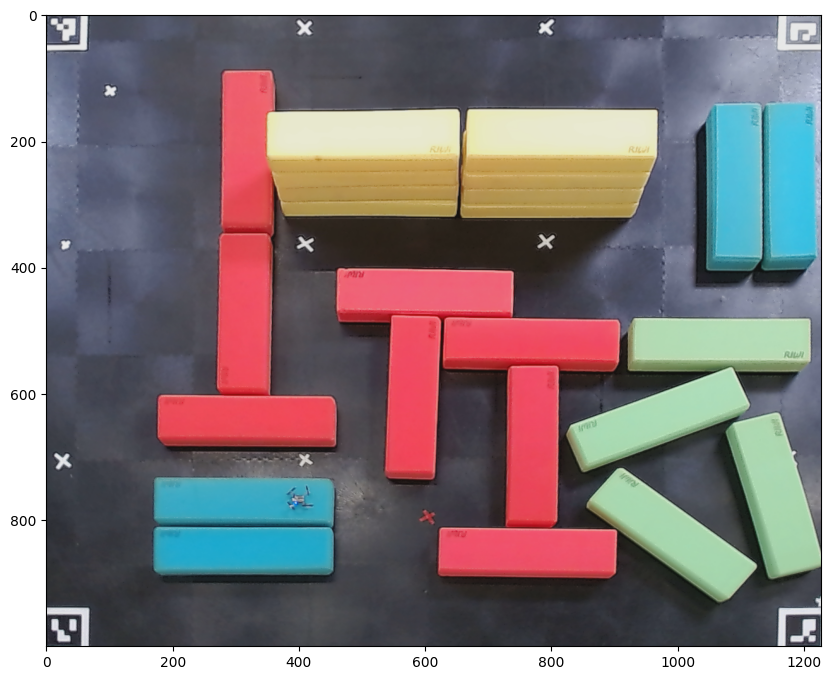

In [ ]:
plt.figure(figsize=(10, 10))
plt.imshow(image)
plt.axis('on')
plt.show()

## Selecting objects with SAM 2

First, load the SAM 2 model and predictor. Change the path below to point to the SAM 2 checkpoint. Running on CUDA and using the default model are recommended for best results.

In [ ]:
from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor
from sam2.automatic_mask_generator import SAM2AutomaticMaskGenerator

sam2_checkpoint = "../checkpoints/sam2.1_hiera_large.pt"
model_cfg = "configs/sam2.1/sam2.1_hiera_l.yaml"

sam2_model = build_sam2(model_cfg, sam2_checkpoint, device=device)

predictor = SAM2ImagePredictor(sam2_model)

Process the image to produce an image embedding by calling `SAM2ImagePredictor.set_image`. `SAM2ImagePredictor` remembers this embedding and will use it for subsequent mask prediction.

In [ ]:
predictor.set_image(image)

To select the truck, choose a point on it. Points are input to the model in (x,y) format and come with labels 1 (foreground point) or 0 (background point). Multiple points can be input; here we use only one. The chosen point will be shown as a star on the image.

In [ ]:
input_point = np.array([[408, 190]])
input_label = np.array([1])

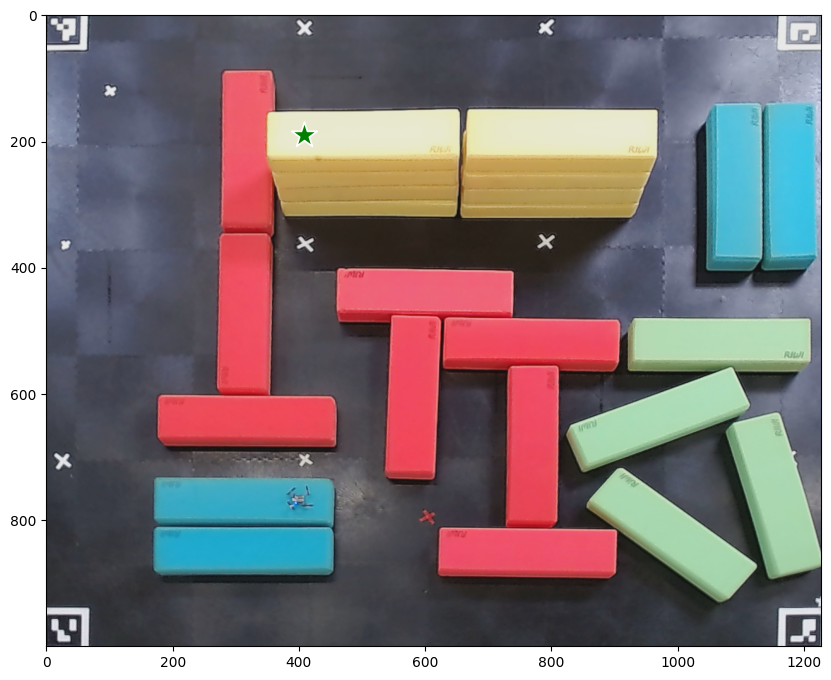

In [ ]:
plt.figure(figsize=(10, 10))
plt.imshow(image)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()

In [ ]:
print(predictor._features["image_embed"].shape, predictor._features["image_embed"][-1].shape)

torch.Size([1, 256, 64, 64]) torch.Size([256, 64, 64])


Predict with `SAM2ImagePredictor.predict`. The model returns masks, quality predictions for those masks, and low resolution mask logits that can be passed to the next iteration of prediction.

In [ ]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)
sorted_ind = np.argsort(scores)[::-1]
masks = masks[sorted_ind]
scores = scores[sorted_ind]
logits = logits[sorted_ind]

With `multimask_output=True` (the default setting), SAM 2 outputs 3 masks, where `scores` gives the model's own estimation of the quality of these masks. This setting is intended for ambiguous input prompts, and helps the model disambiguate different objects consistent with the prompt. When `False`, it will return a single mask. For ambiguous prompts such as a single point, it is recommended to use `multimask_output=True` even if only a single mask is desired; the best single mask can be chosen by picking the one with the highest score returned in `scores`. This will often result in a better mask.

In [ ]:
masks.shape  # (number_of_masks) x H x W

(3, 1000, 1228)

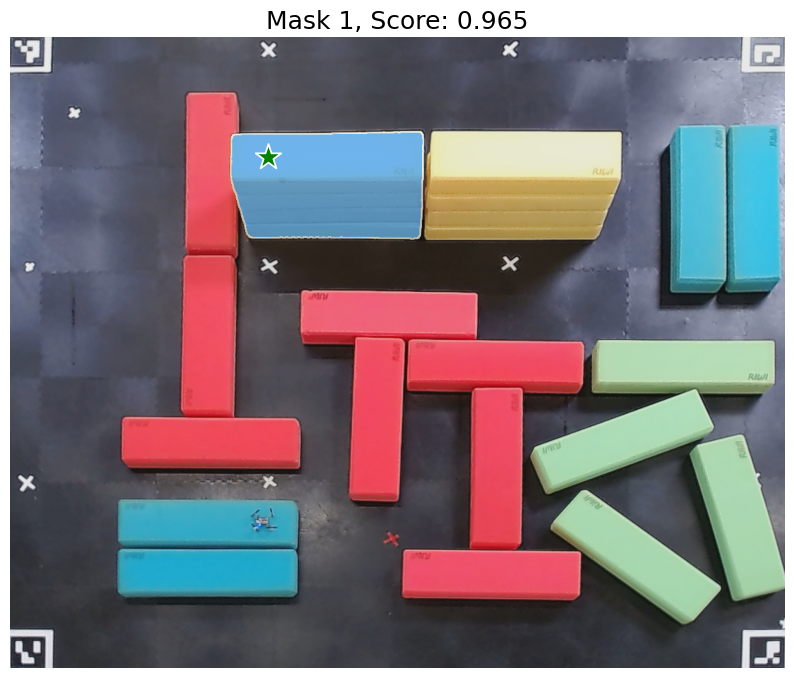

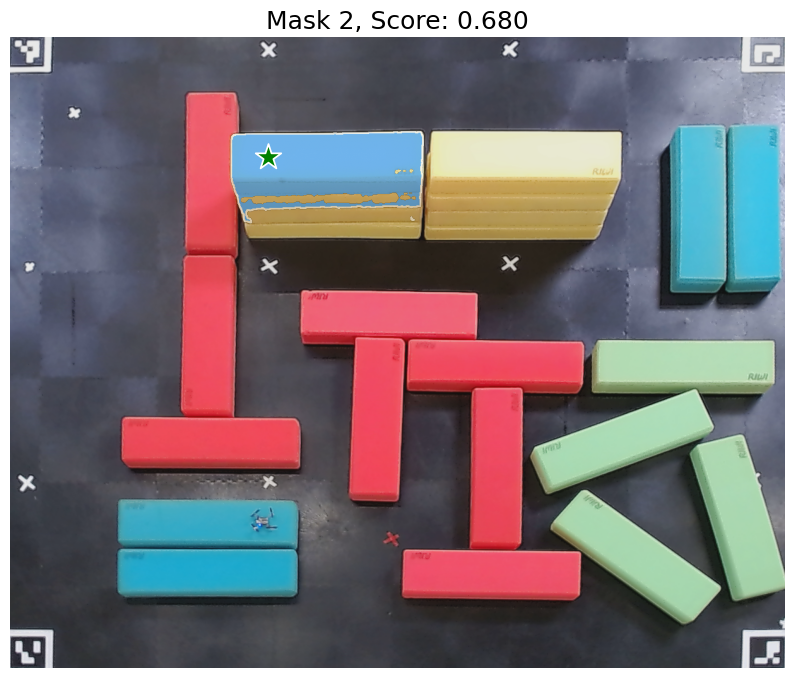

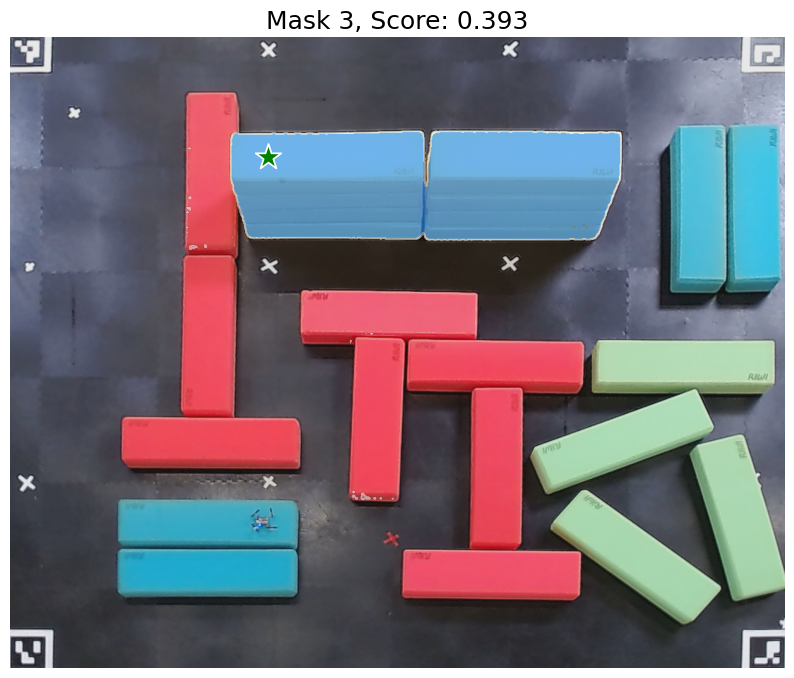

In [ ]:
show_masks(image, masks, scores, point_coords=input_point, input_labels=input_label, borders=True)

## Specifying a specific object with additional points

The single input point is ambiguous, and the model has returned multiple objects consistent with it. To obtain a single object, multiple points can be provided. If available, a mask from a previous iteration can also be supplied to the model to aid in prediction. When specifying a single object with multiple prompts, a single mask can be requested by setting `multimask_output=False`.

In [ ]:
input_point = np.array([[500, 375], [1125, 625]])
input_label = np.array([1, 1])

mask_input = logits[np.argmax(scores), :, :]  # Choose the model's best mask

In [ ]:
masks, scores, _ = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    mask_input=mask_input[None, :, :],
    multimask_output=False,
)

In [ ]:
masks.shape

(1, 1000, 1228)

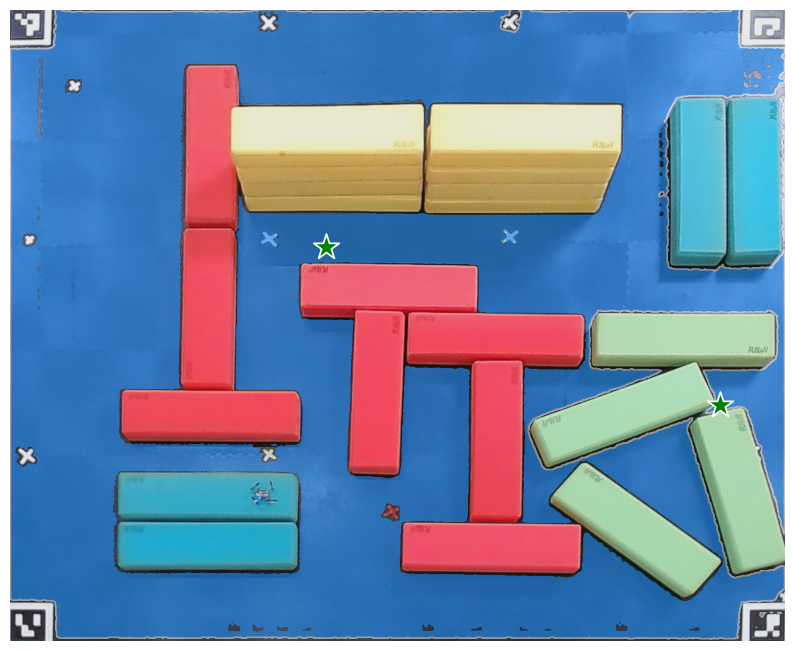

In [ ]:
show_masks(image, masks, scores, point_coords=input_point, input_labels=input_label)

To exclude the car and specify just the window, a background point (with label 0, here shown in red) can be supplied.

In [ ]:
input_point = np.array([[500, 375], [1125, 625]])
input_label = np.array([1, 0])

mask_input = logits[np.argmax(scores), :, :]  # Choose the model's best mask

In [ ]:
masks, scores, _ = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    mask_input=mask_input[None, :, :],
    multimask_output=False,
)

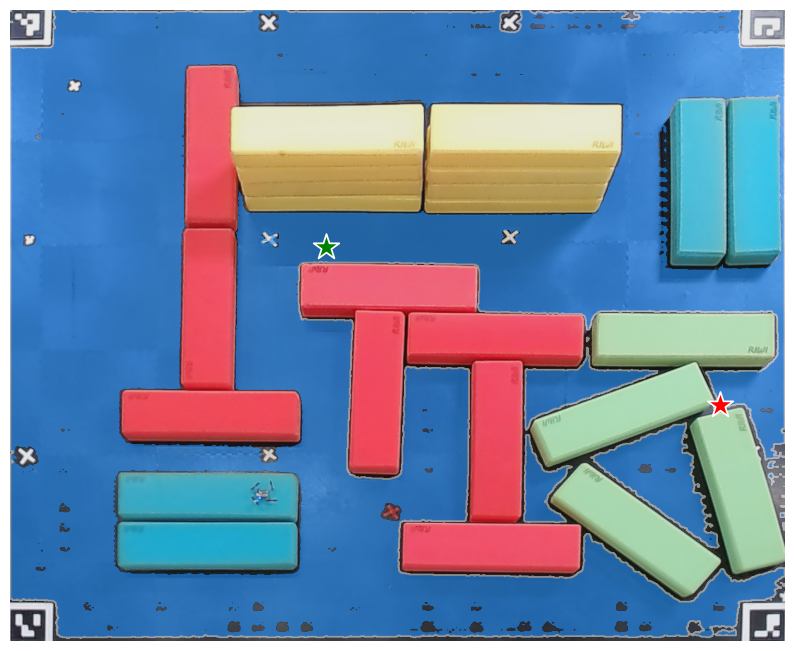

In [ ]:
show_masks(image, masks, scores, point_coords=input_point, input_labels=input_label)

## Specifying a specific object with a box

The model can also take a box as input, provided in xyxy format.

In [ ]:
input_box = np.array([425, 600, 700, 875])

In [ ]:
masks, scores, _ = predictor.predict(
    point_coords=None,
    point_labels=None,
    box=input_box[None, :],
    multimask_output=False,
)

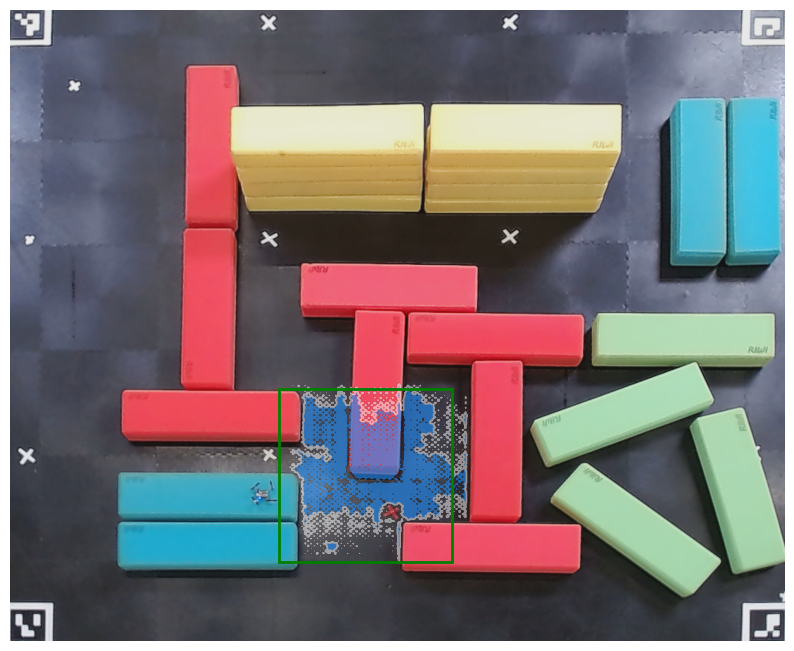

In [ ]:
show_masks(image, masks, scores, box_coords=input_box)

## Combining points and boxes

Points and boxes may be combined, just by including both types of prompts to the predictor. Here this can be used to select just the trucks's tire, instead of the entire wheel.

In [ ]:
input_box = np.array([425, 600, 700, 875])
input_point = np.array([[575, 750]])
input_label = np.array([0])

In [ ]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    box=input_box,
    multimask_output=False,
)

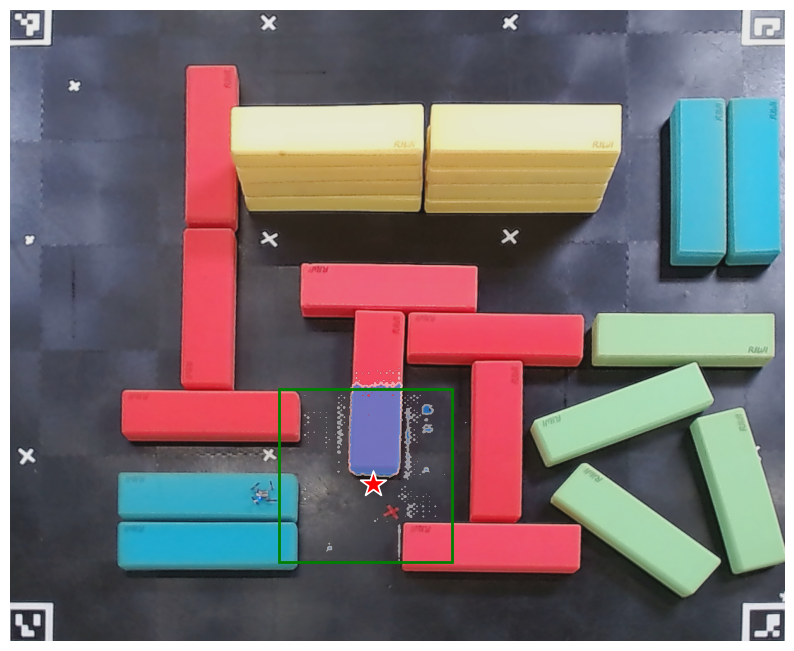

In [ ]:
show_masks(image, masks, scores, box_coords=input_box, point_coords=input_point, input_labels=input_label)

## Batched prompt inputs

:`SAM2ImagePredictor` can take multiple input prompts for the same image, using `predict` method. For example, imagine we have several box outputs from an object detector.

In [ ]:
input_boxes = np.array([
    [75, 275, 1725, 850],
    [425, 600, 700, 875],
    [1375, 550, 1650, 800],
    [1240, 675, 1400, 750],
])

# Create a list of coordinate pairs from the given values
x1, y1 = 25.3, 50.8
x2, y2 = 26.0, 30.5
x3, y3 = 26.5, 65.4
x4, y4 = 46.9, 61.0
x5, y5 = 48.5, 43.5
x6, y6 = 61.6, 85.6
x7, y7 = 62.9, 66.0
x8, y8 = 63.0, 51.9

# Method 1: Create a list of tuples (x, y)
coordinates = [
    [x1, y1],
    [x2, y2],
    [x3, y3],
    [x4, y4],
    [x5, y5],
    [x6, y6],
    [x7, y7],
    [x8, y8]
]

coordinates = [
    [254, 261],
    [434, 184],
    [884, 289]
]

In [ ]:
point_coords = np.array(coordinates)[:, None, ...]
#point_coords[..., 0] *= 10
#point_coords[..., 1] *= 10

point_labels = np.arange(len(coordinates))[:, None]

if False:
  masks, scores, _ = predictor.predict(
      point_coords=point_coords,
      point_labels=point_labels,
      # box=input_boxes,
      multimask_output=True,
  )

In [ ]:
#masks.shape  # (batch_size) x (num_predicted_masks_per_input) x H x W

In [ ]:
if False:
  plt.figure(figsize=(10, 10))
  #plt.imshow(image)
  #for mask in masks:
  #    show_mask(mask.squeeze(0), plt.gca(), random_color=True)
  #for box in input_boxes:
  #    show_box(box, plt.gca())
  #for point in coordinates:
  #    show_point(point)
  for i in range(len(coordinates)):
    sorted_ind = np.argsort(scores[i, ...])[::-1]
    masks_ = masks[i, sorted_ind, ...]
    scores_ = scores[i, sorted_ind]
    show_masks(image, masks_, scores_, point_coords=point_coords[i, ...], input_labels=point_labels[i, ...], borders=True)
  plt.axis('off')
  plt.show()

## End-to-end batched inference
If all prompts are available in advance, it is possible to run SAM 2 directly in an end-to-end fashion. This also allows batching over images.

In [ ]:
image1 = image  # truck.jpg from above
image1_boxes = np.array([
    [75, 275, 1725, 850],
    [425, 600, 700, 875],
    [1375, 550, 1650, 800],
    [1240, 675, 1400, 750],
])

image2 = Image.open('images/groceries.jpg')
image2 = np.array(image2.convert("RGB"))
image2_boxes = np.array([
    [450, 170, 520, 350],
    [350, 190, 450, 350],
    [500, 170, 580, 350],
    [580, 170, 640, 350],
])

img_batch = [image1, image2]
boxes_batch = [image1_boxes, image2_boxes]

In [ ]:
predictor.set_image_batch(img_batch)

In [ ]:
masks_batch, scores_batch, _ = predictor.predict_batch(
    None,
    None,
    box_batch=boxes_batch,
    multimask_output=False
)

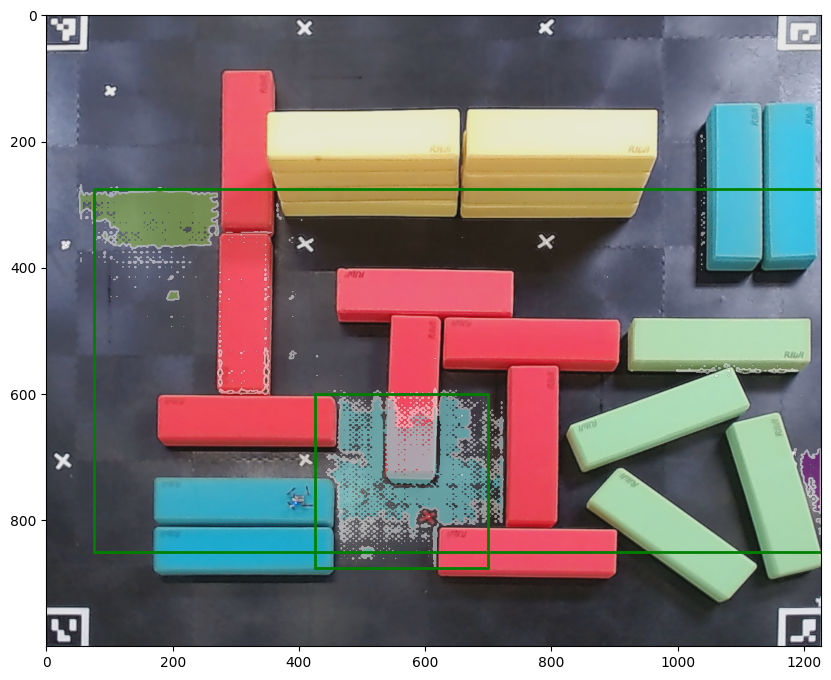

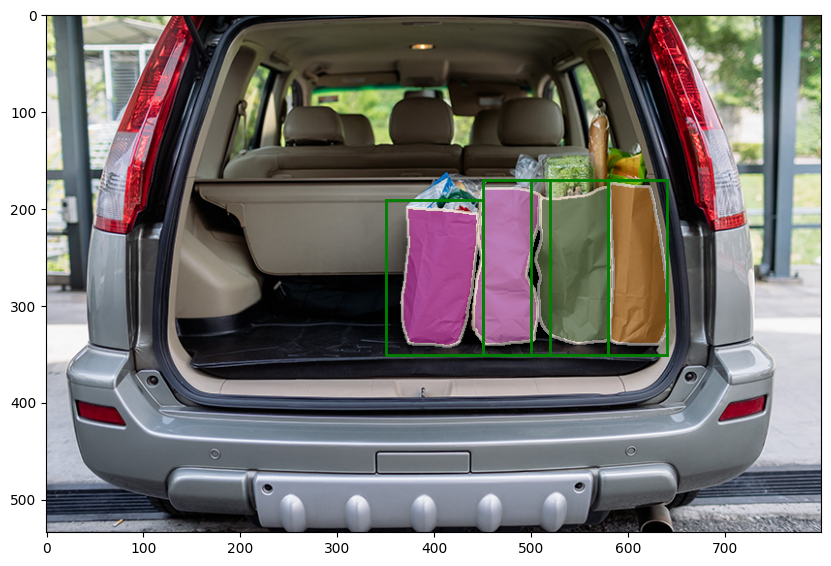

In [ ]:
for image_, boxes, masks in zip(img_batch, boxes_batch, masks_batch):
    plt.figure(figsize=(10, 10))
    plt.imshow(image_)
    for mask in masks:
        show_mask(mask.squeeze(0), plt.gca(), random_color=True)
    for box in boxes:
        show_box(box, plt.gca())

Similarly, we can have a batch of point prompts defined over a batch of images

In [ ]:
image1 = image  # truck.jpg from above
image1_pts = np.array([
    [[500, 375]],
    [[650, 750]]
    ]) # Bx1x2 where B corresponds to number of objects
image1_labels = np.array([[1], [1]])

image2_pts = np.array([
    [[400, 300]],
    [[630, 300]],
])
image2_labels = np.array([[1], [1]])

pts_batch = [image1_pts, image2_pts]
labels_batch = [image1_labels, image2_labels]

In [ ]:
masks_batch, scores_batch, _ = predictor.predict_batch(pts_batch, labels_batch, box_batch=None, multimask_output=True)

# Select the best single mask per object
best_masks = []
for masks, scores in zip(masks_batch,scores_batch):
    best_masks.append(masks[range(len(masks)), np.argmax(scores, axis=-1)])

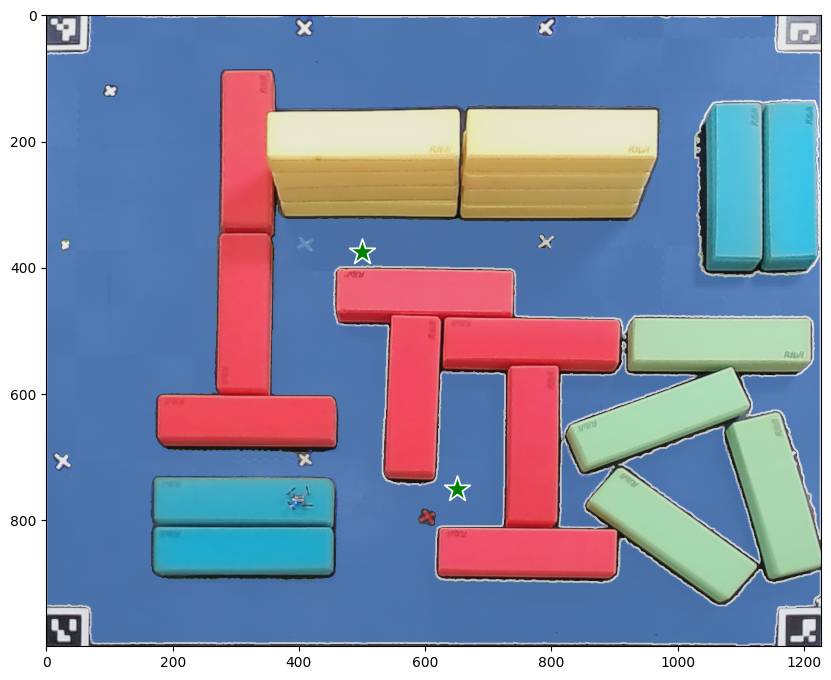

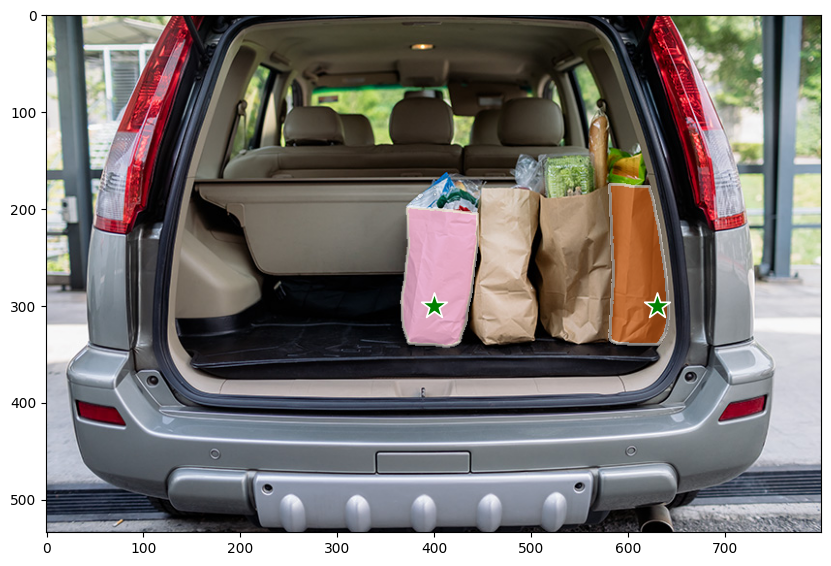

In [ ]:
for image_, points, labels, masks in zip(img_batch, pts_batch, labels_batch, best_masks):
    plt.figure(figsize=(10, 10))
    plt.imshow(image_)
    for mask in masks:
        show_mask(mask, plt.gca(), random_color=True)
    show_points(points, labels, plt.gca())

## Collect all masks in one go

In [ ]:
mask_generator = SAM2AutomaticMaskGenerator(sam2_model)

In [ ]:
results = mask_generator.generate(image)

In [ ]:
len(results), results[5]

(48,
 {'segmentation': array([[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]),
  'area': 22956,
  'bbox': [176.0, 603.0, 283.0, 83.0],
  'predicted_iou': 0.98828125,
  'point_coords': [[364.5625, 609.375]],
  'stability_score': 0.9847456812858582,
  'crop_box': [0.0, 0.0, 1228.0, 1000.0]})

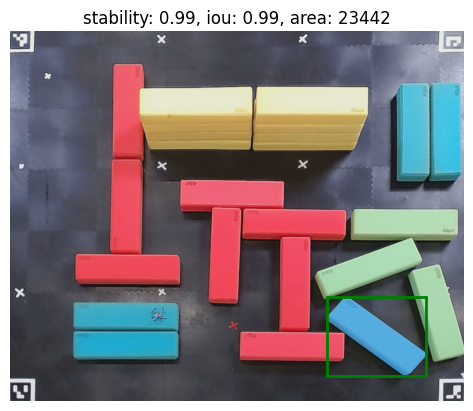

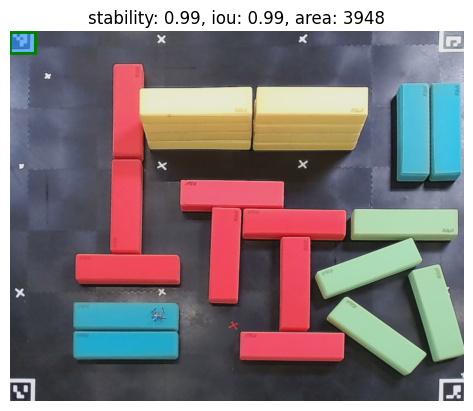

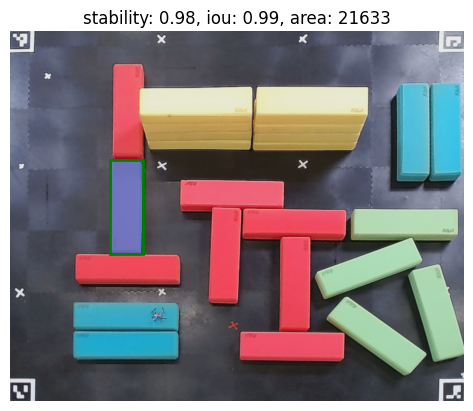

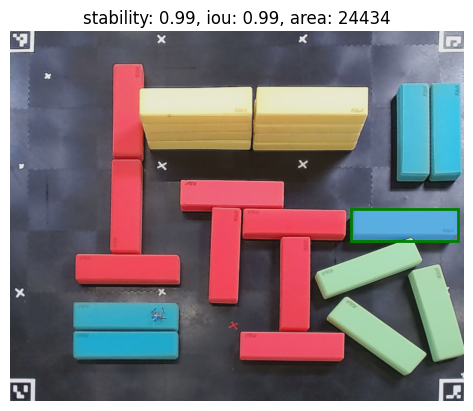

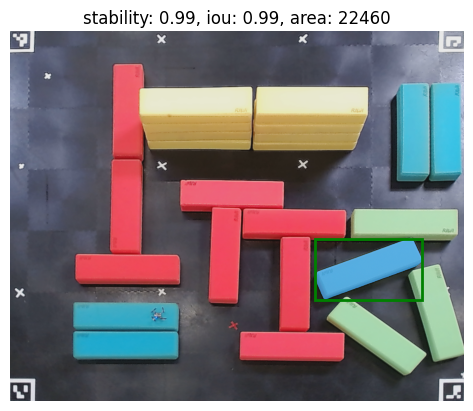

...

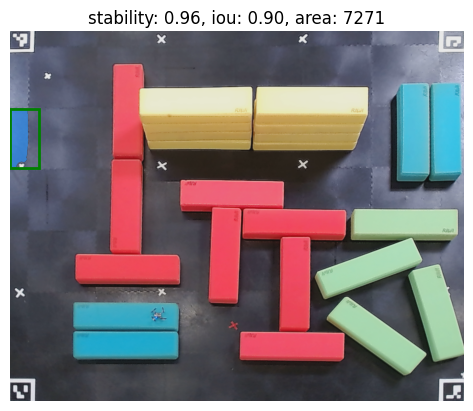

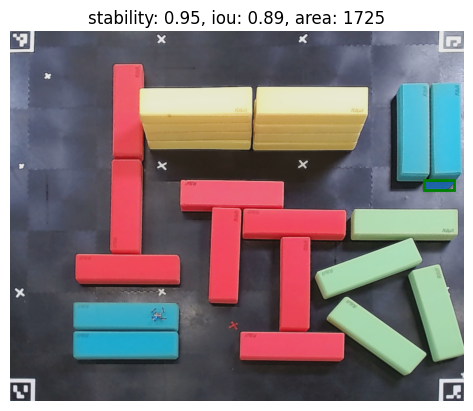

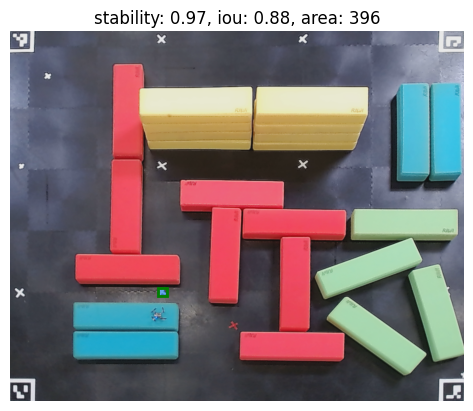

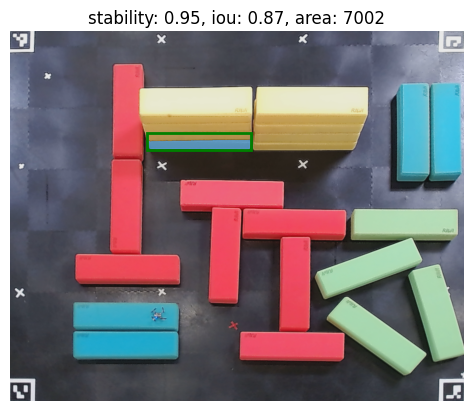

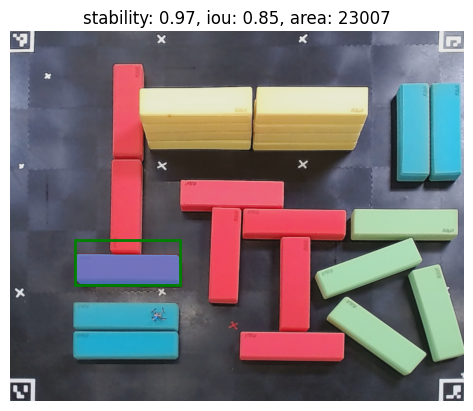

In [ ]:
for entry in results:
    plt.imshow(image)
    show_mask(entry['segmentation'], plt.gca(), random_color=False, borders=False)
    x, y, width, height = entry['bbox']
    show_box([x, y, x+width, y+height], plt.gca())
    plt.title(f"stability: {entry['stability_score']:.2f}, iou: {entry['predicted_iou']:.2f}, area: {entry['area']}")
    plt.axis('off')
    plt.show()


In [ ]:
import cv2
import pandas as pd
import sympy

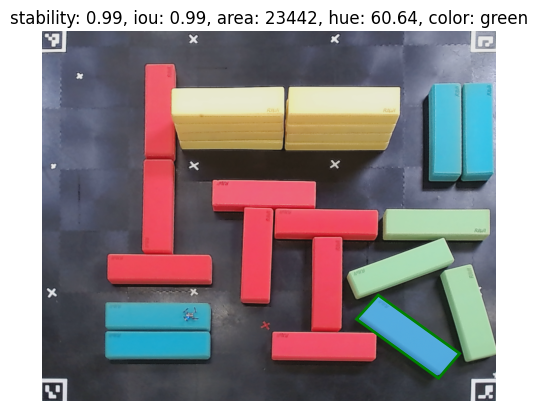

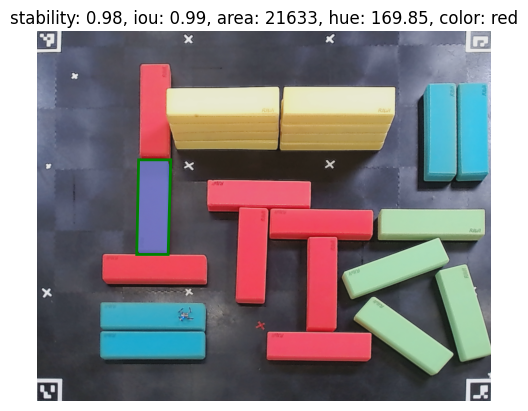

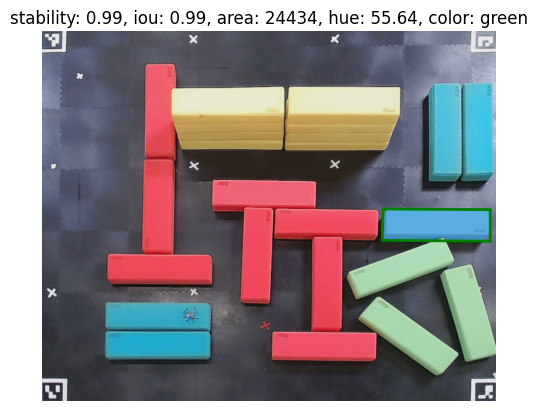

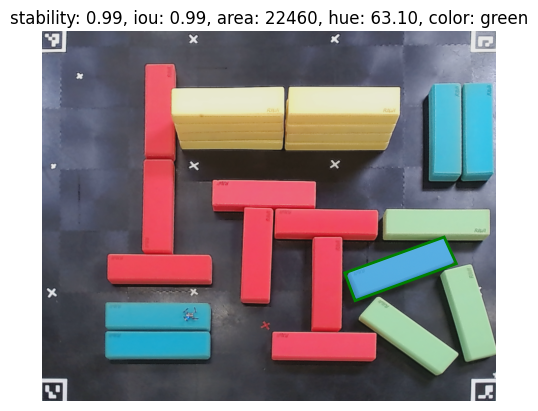

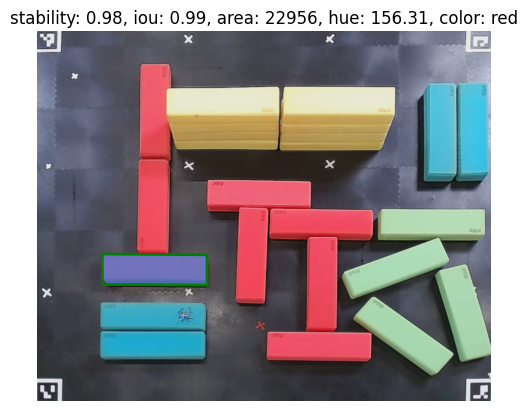

...

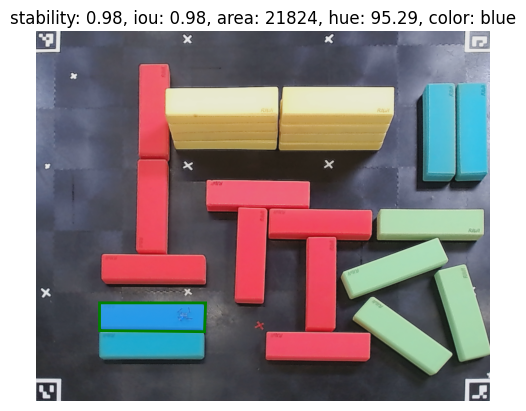

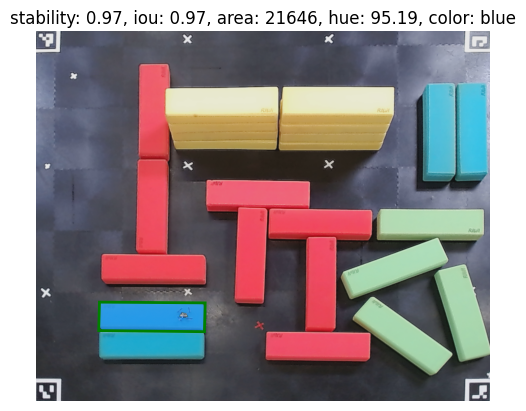

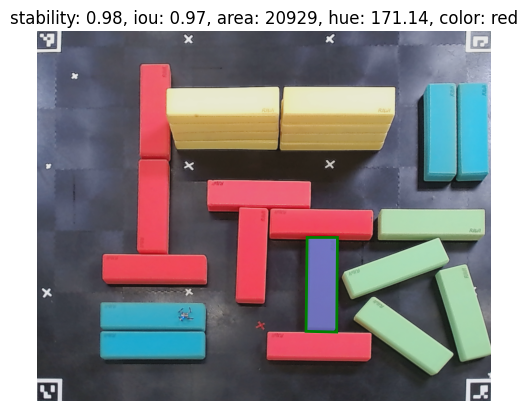

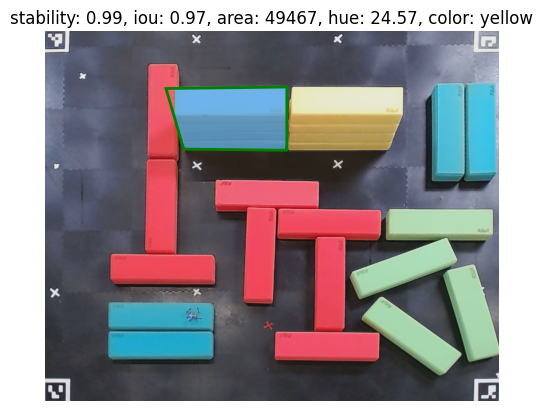

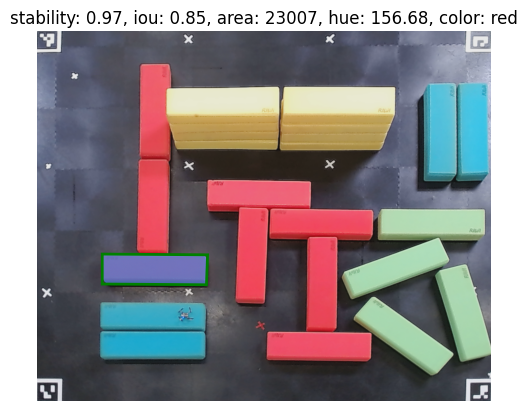

,x,y,width,height,area,stability_score,avg_hue,color,poly_oriented
0,857.0,718.0,268.0,213.0,23442,0.987449,60.639493,green,"[(1129, 871), (1072, 938), (850, 778), (909, 7..."
1,270.0,347.0,88.0,256.0,21633,0.983448,169.852494,red,"[(361, 347), (354, 603), (269, 603), (274, 347)]"
2,921.0,481.0,291.0,86.0,24434,0.991605,55.644512,green,"[(1212, 482), (1212, 567), (920, 565), (922, 4..."
3,824.0,560.0,290.0,165.0,22460,0.986512,63.096527,green,"[(1120, 628), (846, 728), (818, 653), (1087, 5..."
4,176.0,603.0,283.0,83.0,22956,0.984746,156.305280,red,"[(459, 604), (459, 686), (176, 684), (176, 602)]"
5,1078.0,631.0,149.0,263.0,23535,0.984483,62.889356,green,"[(1236, 874), (1144, 895), (1072, 649), (1165,..."
6,275.0,89.0,87.0,511.0,20281,0.984647,157.864947,red,"[(359, 350), (276, 344), (278, 90), (362, 88)]"
7,277.0,89.0,85.0,261.0,20277,0.985652,157.793017,red,"[(359, 350), (276, 344), (278, 90), (362, 88)]"
8,459.0,403.0,281.0,85.0,21677,0.986254,168.381510,red,"[(740, 405), (740, 478), (458, 491), (460, 401)]"
9,537.0,477.0,89.0,260.0,20830,0.985040,168.560922,red,"[(626, 478), (615, 738), (535, 734), (545, 476)]"


<Figure size 640x480 with 0 Axes>

In [ ]:
def appx_best_fit_ngon_from_mask(mask, n: int = 4):
    """Adapted from: https://medium.com/@hackable-projects/efficiently-drawing-bounding-boxes-around-segmented-masks-a-tale-of-two-algorithms-faae810bb8a8
    """

    contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # This might return multiple contours, is the mask is not very clean
    # We assume that each mask cooresponds to a single object and therefore
    # only take the largest (=longest) contour of all found ones and discard
    # all other ones
    lengths = [len(contour) for contour in contours]
    main_contour = contours[np.argmax(lengths)]
    assert len(main_contour) >= n

    hull = cv2.convexHull(main_contour)
    hull = np.array(hull).reshape((len(hull), 2))

    # Convert to sympy Points
    hull = [sympy.Point(*pt) for pt in hull]

    # Iteratively approximate to n-gon
    while len(hull) > n:
        best_candidate = None
        for edge_idx_1 in range(len(hull)):
            edge_idx_2 = (edge_idx_1 + 1) % len(hull)
            adj_idx_1 = (edge_idx_1 - 1) % len(hull)
            adj_idx_2 = (edge_idx_1 + 2) % len(hull)

            edge_pt_1, edge_pt_2 = hull[edge_idx_1], hull[edge_idx_2]
            adj_pt_1, adj_pt_2 = hull[adj_idx_1], hull[adj_idx_2]

            subpoly = sympy.Polygon(adj_pt_1, edge_pt_1, edge_pt_2, adj_pt_2)
            angle1, angle2 = subpoly.angles[edge_pt_1], subpoly.angles[edge_pt_2]

            if sympy.N(angle1 + angle2) <= sympy.pi:
                continue

            adj_edge_1, adj_edge_2 = sympy.Line(adj_pt_1, edge_pt_1), sympy.Line(edge_pt_2, adj_pt_2)
            intersect = adj_edge_1.intersection(adj_edge_2)[0]

            area = sympy.N(sympy.Triangle(edge_pt_1, intersect, edge_pt_2).area)
            if best_candidate and best_candidate[1] < area:
                continue

            better_hull = list(hull)
            better_hull[edge_idx_1] = intersect
            del better_hull[edge_idx_2]
            best_candidate = (better_hull, area)

        if not best_candidate:
            raise ValueError("Could not find the best fit n-gon!")

        hull = best_candidate[0]

    # Convert back to integer coordinates for drawing
    hull = [(int(x.evalf()), int(y.evalf())) for x, y in hull]

    return hull

image_hsl = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
hue = image_hsl[:, :, 0]

# Maps from a name to a hue
known_color_labels = {
    "red": 0,
    "yellow": 30,
    "green": 65,
    "blue": 100,
}
HUE_MAX = 179

results_for_export = []
all_masks = []
for entry in results:
    # area = entry['bbox'][2] * entry['bbox'][3]
    area = entry['area']
    if area < 100*100 or area > 300*200:
        continue

    mask = entry['segmentation']
    all_masks.append(mask)
    avg_hue = hue[mask].mean()

    # find the closest one with a simple numpy min()
    distances = [
        # We compare on a disk
        min(abs(avg_hue - label_hue), HUE_MAX - abs(avg_hue - label_hue))
        for label_hue in known_color_labels.values()
    ]
    color = list(known_color_labels.keys())[np.argmin(distances)]

    plt.imshow(image)
    show_mask(mask, plt.gca(), random_color=False, borders=False)
    # x, y, width, height = entry['bbox']
    # show_box([x, y, x+width, y+height], plt.gca())

    box_oriented = appx_best_fit_ngon_from_mask(mask.astype(np.uint8))
    show_box_oriented(box_oriented, plt.gca())

    plt.title(f"stability: {entry['stability_score']:.2f}, iou: {entry['predicted_iou']:.2f}, area: {entry['area']}, hue: {avg_hue:.2f}, color: {color}")
    plt.axis('off')
    plt.show()
    plt.clf()

    results_for_export.append(entry['bbox'] + [area, entry['stability_score'], avg_hue, color, box_oriented])

df = pd.DataFrame(results_for_export, columns=['x', 'y', 'width', 'height', 'area', 'stability_score', 'avg_hue', 'color', 'poly_oriented'])
df.to_csv('bounding_boxes.csv', index=False)

df

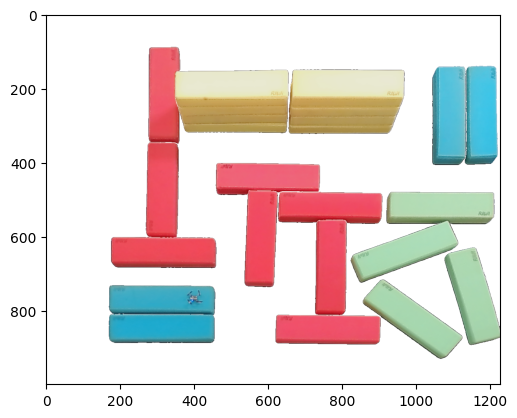

In [ ]:
# Visualize the mask over all objects
combined_mask = all_masks[0]
for mask in all_masks:
    combined_mask = np.logical_or(combined_mask, mask)

# Convert RGB->RGBA
image_masked_color = cv2.cvtColor(image, cv2.COLOR_RGB2RGBA)
image_masked_color[~combined_mask, -1] = 0  # Set the alpha to fully transparent

as_image = Image.fromarray(image_masked_color)
as_image.save("combined_mask.png")

plt.imshow(as_image)
plt.show()

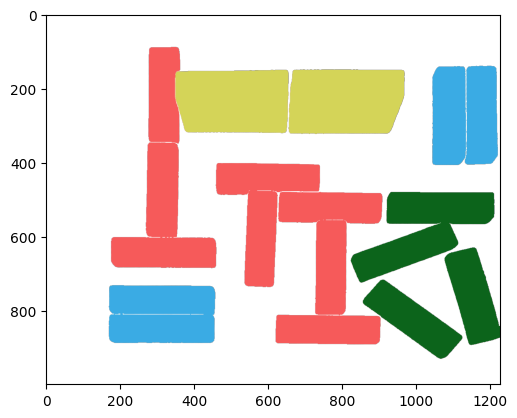

In [ ]:
# Reconstruct the patches
artifical_color_hsl = image_hsl.copy()

COLOR_TO_S = {
    "red": 168,
    "yellow": 150,
    "green": 56,
    "blue": 143,
}
COLOR_TO_L = {
    "red": 228,
    "yellow": 150,
    "green": 199,
    "blue": 194,
}

for mask, (_, data) in zip(all_masks, df.iterrows()):
    #print("---")
    #print(data["color"])
    #print("s:", image_hsl[mask, 1].mean())
    #print("l:", image_hsl[mask, 2].mean())
    artifical_color_hsl[mask, 0] = known_color_labels[data["color"]]
    artifical_color_hsl[mask, 1] = COLOR_TO_S[data["color"]]
    artifical_color_hsl[mask, 2] = COLOR_TO_L[data["color"]]

artifical_color_rgb = cv2.cvtColor(artifical_color_hsl, cv2.COLOR_HLS2RGB)
artifical_color_rgba = cv2.cvtColor(artifical_color_rgb, cv2.COLOR_RGB2RGBA)
artifical_color_rgba[~combined_mask, -1] = 0  # Set the alpha to fully transparent

as_image = Image.fromarray(artifical_color_rgba)
as_image.save("artifical_color.png")

plt.imshow(as_image)
plt.show()